

---


# **Pre-processing & Exploratory Data Analysis**


---


This script loads, cleans, and preprocesses time-series data
for further modeling and analysis. It also performs
exploratory visualizations and exports processed datasets.

# **1. Data Setup & Configuration**

*   Import required libraries (pandas, numpy, matplotlib, seaborn, pvlib, etc.)
*   Set configuration (file paths, site latitude/longitude, altitude, timezone)
*   Load dataset from Excel

In [ ]:
# --- 1. Install & Imports---
!pip install pvlib
!pip install pysolar
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from pvlib import solarposition
from pysolar.solar import get_altitude, get_azimuth
import pandas as pd
from datetime import timedelta
import pytz
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import spearmanr

In [ ]:
# --- 2. Configuration ---
DATA_PATH = Path("/content/PLRT.xlsx")  # Adjust path if needed
SITE_LAT = -7.00589      # Example: replace with your site latitude
SITE_LON = 106.562      # Example: replace with your site longitude
SITE_ALT = 49         # Altitude in meters
TIMEZONE = "Asia/Jakarta"

# --- 3. Load Data ---
df = pd.read_excel(DATA_PATH)
print(f"Loaded dataset shape: {df.shape}")

Loaded dataset shape: (100654, 96)


# **2. Time Handling & Sorting**

*   Convert 'Time' column to datetime (DD/MM/YYYY hh:mm:ss format)
*   Sort dataset by 'Time' to ensure chronological order
*   Select relevant columns for processing

In [ ]:
# --- 4. Convert 'Time' to datetime ---
df['Time'] = pd.to_datetime(df['Time'], format="%d/%m/%Y %H:%M:%S")

# --- 5. Sort by Time ---
df.sort_values(by='Time', inplace=True)

# --- 6. Select relevant columns ---
selected_columns = [
    'Time',
    'rr',          # Rainfall rate (mm)
    'ws_avg',      # Average wind speed (m/s)
    'ws_max',      # Maximum wind speed (m/s)
    'wd_avg',      # Average wind direction
    'tt_air_max',  # Maximum air temperature (°C)
    'tt_air_avg',  # Average air temperature (°C)
    'tt_air_min',  # Minimum air temperature (°C)
    'rh_avg',      # Average relative humidity (%)
    'pp_air',      # Air pressure (Pa)
    'sr_avg',      # Average solar irradiance (W/m²)
    'sr_max'       # Maximum solar irradiance (W/m²)
]
df = df[selected_columns]

# --- 7. Reset index after sorting ---
df.reset_index(drop=True, inplace=True)


In [ ]:
df.head()

,Time,rr,ws_avg,ws_max,wd_avg,tt_air_max,tt_air_avg,tt_air_min,rh_avg,pp_air,sr_avg,sr_max
0,2022-01-01 00:00:00,22.4,0.063321,0.067418,276.420,23.409,23.289,23.198,97.468,1005.1,101.240,103.580
1,2022-01-01 00:10:00,0.0,0.060870,0.066272,102.220,23.730,23.545,23.395,97.409,1005.2,88.773,101.660
2,2022-01-01 00:20:00,0.0,0.090886,0.801750,145.340,23.778,23.734,23.692,96.611,1005.1,64.827,72.624
3,2022-01-01 00:30:00,0.0,0.091676,0.603920,146.240,23.709,23.671,23.609,96.096,1004.9,56.074,58.854
4,2022-01-01 00:40:00,0.0,0.060649,0.065432,65.288,23.685,23.625,23.584,95.710,1004.9,50.583,53.033


# **3. Exploratory Data Analysis (EDA)**

* Display descriptive statistics (mean, median, std, etc.)
* Visualize selected columns over time with line plots

In [ ]:
# --- 7. Descriptive statistics ---
print("\nDataset Statistics:")
print(df.describe().T)


Dataset Statistics:
              count                           mean                  min  \
Time         100654  2023-01-07 14:00:51.652194816  2022-01-01 00:00:00   
rr          96217.0                       2.511695                  0.0   
ws_avg      96217.0                       1.334642             0.055409   
ws_max      96217.0                        2.76199             0.057518   
wd_avg      96217.0                     196.268841              0.34796   
tt_air_max  96217.0                      25.788439                17.38   
tt_air_avg  96217.0                      25.658877               17.351   
tt_air_min  96217.0                      25.531202                  0.0   
rh_avg      96217.0                       85.58637               35.801   
pp_air      96217.0                    1003.880974               955.87   
sr_avg      96217.0                     200.410143                  0.0   
sr_max      96217.0                     229.683431                  0.0   

   

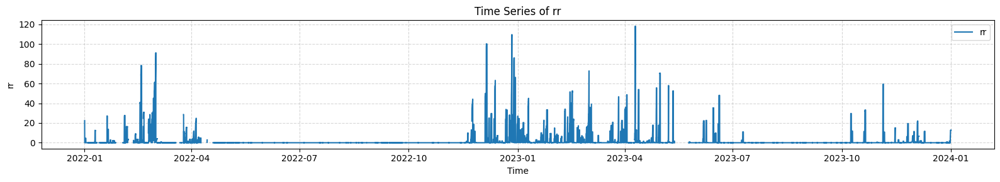

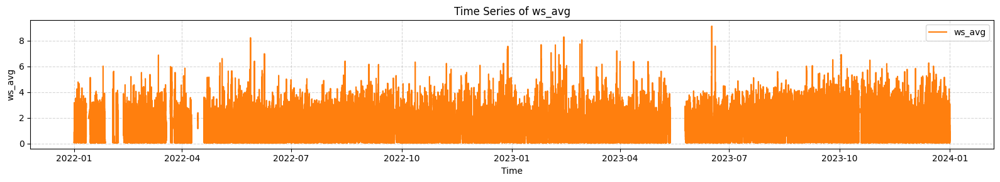

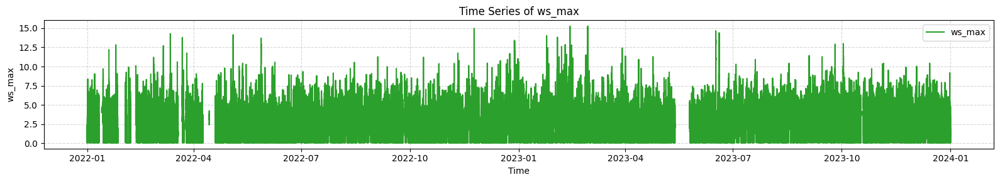

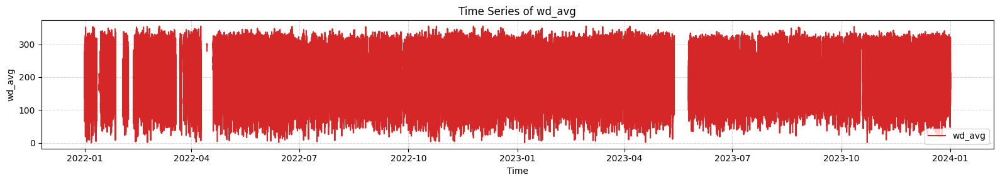

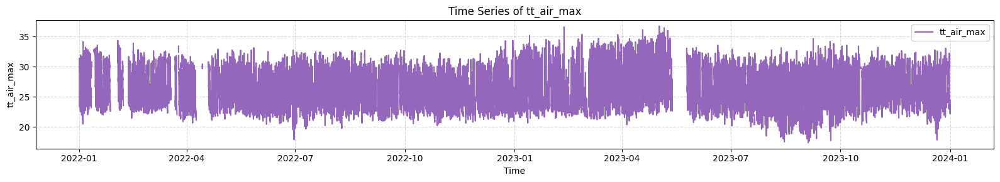

...

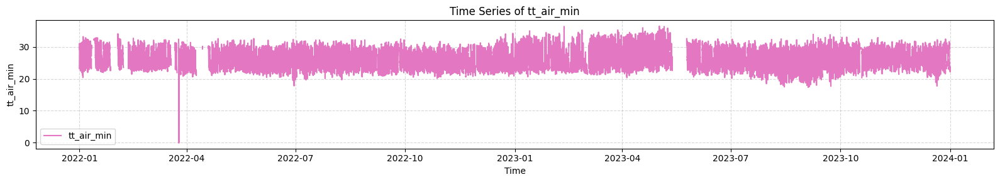

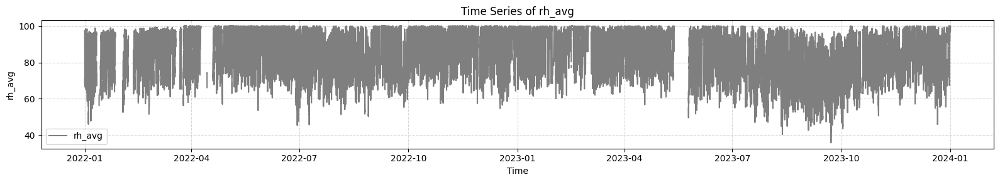

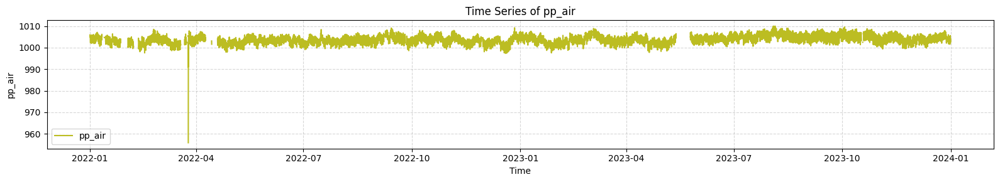

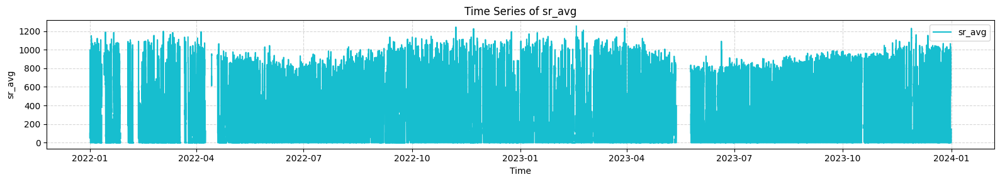

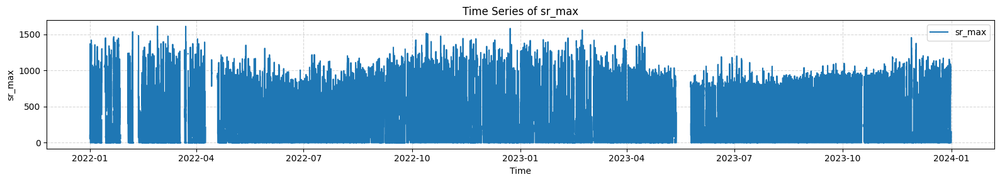

In [ ]:
# --- 8. Visualize selected columns ---
import matplotlib.pyplot as plt
# Define a color palette
colors = plt.cm.tab10.colors  # 10 distinct colors
# Visualize each column separately with different colors
for idx, col in enumerate(selected_columns[1:]):  # Skip 'Time' column
    plt.figure(figsize=(16, 3))
    plt.plot(df['Time'], df[col], label=col, color=colors[idx % len(colors)])
    plt.xlabel("Time")
    plt.ylabel(col)
    plt.title(f"Time Series of {col}")
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.legend()
    plt.tight_layout()
    plt.show()


# **4. Missing Timestep Detection & Filling**



* Check for missing timesteps (expected: 10-minute interval)
* Create a full datetime index covering the period
* Reindex DataFrame to fill in missing timestamps

In [ ]:
# --- 9. Check missing timesteps (10-minute interval) ---
full_time_index = pd.date_range(start=df['Time'].min(),
                                end=df['Time'].max(),
                                freq="10min")
missing_timestamps = full_time_index.difference(df['Time'])
print(f"Missing timestamps: {len(missing_timestamps)}")

Missing timestamps: 4466


In [ ]:
# --- 10. Fill missing timesteps ---
df_full = df.set_index('Time').reindex(full_time_index).rename_axis('Time').reset_index()

# --- 11. Export full timestep version ---
df_full.to_excel("/content/02_PLRT_full_timestep.xlsx", index=False)
print("Exported full timestep version to full_timestep.xlsx")

Exported full timestep version to full_timestep.xlsx


In [ ]:
df_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 105120 entries, 0 to 105119
Data columns (total 12 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   Time        105120 non-null  datetime64[ns]
 1   rr          96217 non-null   float64       
 2   ws_avg      96217 non-null   float64       
 3   ws_max      96217 non-null   float64       
 4   wd_avg      96217 non-null   float64       
 5   tt_air_max  96217 non-null   float64       
 6   tt_air_avg  96217 non-null   float64       
 7   tt_air_min  96217 non-null   float64       
 8   rh_avg      96217 non-null   float64       
 9   pp_air      96217 non-null   float64       
 10  sr_avg      96217 non-null   float64       
 11  sr_max      96217 non-null   float64       
dtypes: datetime64[ns](1), float64(11)
memory usage: 9.6 MB


# **5. Missing Value Handling (Interpoalation)**

* Check NaN counts per column
* Apply linear interpolation (both forward & backward)
* Re-check NaN counts

In [ ]:
# --- 12. Check NaN count ---
print("\nNaN count per column (before interpolation):")
print(df_full.isna().sum())


NaN count per column (before interpolation):
Time             0
rr            8903
ws_avg        8903
ws_max        8903
wd_avg        8903
tt_air_max    8903
tt_air_avg    8903
tt_air_min    8903
rh_avg        8903
pp_air        8903
sr_avg        8903
sr_max        8903
dtype: int64


In [ ]:
# --- 13. Fill NaN with linear interpolation (both directions) ---
df_interp = df_full.interpolate(method='linear', limit_direction='both')

# --- 14. Re-check NaN ---
print("\nNaN count per column (after interpolation):")
print(df_interp.isna().sum())


NaN count per column (after interpolation):
Time          0
rr            0
ws_avg        0
ws_max        0
wd_avg        0
tt_air_max    0
tt_air_avg    0
tt_air_min    0
rh_avg        0
pp_air        0
sr_avg        0
sr_max        0
dtype: int64


In [ ]:
# --- 15. Export interpolated version ---
df_interp.to_excel("/content/03_PLRT_interpolated.xlsx", index=False)
print("Exported interpolated version to interpolated.xlsx")

Exported interpolated version to interpolated.xlsx


# **6. Feature Engineering (Time & Solar Geometry)**

* Create 'WIB' column: 'Time' + 7 hours, formatted as datetime
* Compute solar zenith, azimuth, and elevation angles using pvlib.solarposition and site coordinates
* Extract temporal features: Hour, Date, Day of Year (DOY), Month

In [ ]:
# --- 16. Add WIB column (7 hours ahead of Time) ---
df_interp['WIB'] = df_interp['Time'] + pd.Timedelta(hours=7)
df_interp['WIB'] = pd.to_datetime(df_interp['WIB'])  # Ensure datetime
# Move WIB to first column
cols = ['WIB'] + [c for c in df_interp.columns if c != 'WIB']
df_interp = df_interp[cols]


In [ ]:
# --- 17. Add Sun Geometry Features ---
# --- Timezone ---
local_tz = pytz.timezone(TIMEZONE)
# --- Get start and end time from dataset (WIB column) ---
start_time = df_interp['WIB'].iloc[0]
end_time = df_interp['WIB'].iloc[-1]
# Ensure WIB is timezone-aware for pysolar
start_time = local_tz.localize(start_time)
end_time = local_tz.localize(end_time)
# --- Loop through each 10-minute step ---
data = []
current_time = start_time
while current_time <= end_time:
    # Solar altitude (elevation)
    solar_altitude = get_altitude(SITE_LAT, SITE_LON, current_time)
    # Solar zenith angle
    zenith_angle = 90 - solar_altitude
    # Solar azimuth
    solar_azimuth = get_azimuth(SITE_LAT, SITE_LON, current_time)
    data.append([current_time, solar_altitude, solar_azimuth, zenith_angle])
    # Increment time
    current_time += timedelta(minutes=10)  # Match your dataset's interval
# --- Convert to DataFrame ---
df_solar = pd.DataFrame(data, columns=['WIB', 'Sun_Altitude', 'Sun_Azimuth', 'Sun_Zenith_Angle'])
# Convert timezone-aware WIB → timezone-naive
df_solar['WIB'] = df_solar['WIB'].dt.tz_localize(None)
# --- Merge with main dataset ---
df_interp = df_interp.merge(df_solar, on='WIB', how='left')

In [ ]:
# --- 18. Add temporal features ---
df_interp['Hour'] = df_interp['WIB'].dt.hour
df_interp['Date'] = df_interp['WIB'].dt.date
df_interp['DOY'] = df_interp['WIB'].dt.dayofyear
df_interp['Month'] = df_interp['WIB'].dt.month

In [ ]:
# Make sure Date is datetime
df_interp['Date'] = pd.to_datetime(df_interp['Date'])
df_interp['Day'] = df_interp['Date'].dt.day
df_interp['Year'] = df_interp['Date'].dt.year

In [ ]:
print(df_interp.head())
print(df_interp.info())

                  WIB                Time    rr    ws_avg    ws_max   wd_avg  \
0 2022-01-01 07:00:00 2022-01-01 00:00:00  22.4  0.063321  0.067418  276.420   
1 2022-01-01 07:10:00 2022-01-01 00:10:00   0.0  0.060870  0.066272  102.220   
2 2022-01-01 07:20:00 2022-01-01 00:20:00   0.0  0.090886  0.801750  145.340   
3 2022-01-01 07:30:00 2022-01-01 00:30:00   0.0  0.091676  0.603920  146.240   
4 2022-01-01 07:40:00 2022-01-01 00:40:00   0.0  0.060649  0.065432   65.288   

   tt_air_max  tt_air_avg  tt_air_min  rh_avg  ...   sr_max  Sun_Altitude  \
0      23.409      23.289      23.198  97.468  ...  103.580     17.246138   
1      23.730      23.545      23.395  97.409  ...  101.660     19.539923   
2      23.778      23.734      23.692  96.611  ...   72.624     21.834579   
3      23.709      23.671      23.609  96.096  ...   58.854     24.129065   
4      23.685      23.625      23.584  95.710  ...   53.033     26.422407   

   Sun_Azimuth  Sun_Zenith_Angle  Hour       Date  DOY M

In [ ]:
# --- (Optional) Export to Excel ---
df_interp.to_excel('04_PLRT_FeatureEngineered.xlsx', index=False)

# **7. Resampling**

* Resample dataset to hourly
* Export hourly dataset to Excel

In [ ]:
# --- 21. Resample to hourly interval ---
df_hourly = df_interp.set_index('WIB').resample('h').first().reset_index()
# --- 22. Export hourly resampled version ---
df_hourly.to_excel("/content/05_PLRT_h_resampled.xlsx", index=False)
print("Exported hourly resampled version to hourly_resampled.xlsx")

Exported hourly resampled version to hourly_resampled.xlsx


In [ ]:
df_hourly.head()

,WIB,Time,rr,ws_avg,ws_max,wd_avg,tt_air_max,tt_air_avg,tt_air_min,rh_avg,...,sr_max,Sun_Altitude,Sun_Azimuth,Sun_Zenith_Angle,Hour,Date,DOY,Month,Day,Year
0,2022-01-01 07:00:00,2022-01-01 00:00:00,22.4,0.063321,0.067418,276.420,23.409,23.289,23.198,97.468,...,103.580,17.246138,111.987039,72.753862,7,2022-01-01,1,1,1,2022
1,2022-01-01 08:00:00,2022-01-01 01:00:00,0.0,0.382610,1.635900,82.138,23.739,23.669,23.588,95.020,...,65.549,31.001774,112.686693,58.998226,8,2022-01-01,1,1,1,2022
2,2022-01-01 09:00:00,2022-01-01 02:00:00,0.0,0.073791,0.698300,206.460,27.372,26.565,25.617,87.571,...,850.440,44.597536,115.588039,45.402464,9,2022-01-01,1,1,1,2022
3,2022-01-01 10:00:00,2022-01-01 03:00:00,0.0,1.191000,2.684700,158.110,29.407,29.101,28.937,76.185,...,965.050,57.642335,122.803020,32.357665,10,2022-01-01,1,1,1,2022
4,2022-01-01 11:00:00,2022-01-01 04:00:00,0.0,1.569700,3.042600,233.590,30.896,30.811,30.613,67.713,...,1084.100,68.924096,140.889270,21.075904,11,2022-01-01,1,1,1,2022


# **8. Data Visualization**

* Evaluate Data Trends & Pattern

In [ ]:
# --- 24. Visualization Configuration ---
sns.set_style("whitegrid")

EXCLUDE_COLS = ['WIB', 'Date', 'Time', 'Hour', 'DOY', 'Month']
YEARS_SORTED = [2022, 2023]
COLORS = plt.cm.tab10.colors

# Columns to plot
PLOT_COLUMNS = [col for col in df_hourly.columns if col not in EXCLUDE_COLS]

In [ ]:
# --- 25. Graph Loop Function ---
def plot_monthly_faceted(df, plot_columns, years_sorted, colors, aggregated=False):
    """
    Plot monthly faceted line plots (hourly or daily aggregated).
    - aggregated=False: hourly data without error bars.
    - aggregated=True: daily aggregated data with SD error bars.
    """
    for idx, col in enumerate(plot_columns):
        fig, axes = plt.subplots(
            nrows=4, ncols=6,
            figsize=(20, 12),
            sharey=False
        )

        title_type = "Monthly Plots" if not aggregated else "Monthly (Daily Aggregated) Plots"
        fig.suptitle(f"{col} — {title_type} Jan 2022 to Dec 2023",
                     fontsize=18, y=1.02, fontweight='semibold')

        month_idx = 0
        for year in years_sorted:
            for month in range(1, 13):
                r, c = divmod(month_idx, 6)
                ax = axes[r, c]

                subset = df[(df['Year'] == year) & (df['Month'] == month)]

                if aggregated and not subset.empty:
                    # Aggregate by day
                    sns.lineplot(
                        data=subset,
                        x=subset['WIB'].dt.day,
                        y=col,
                        ax=ax,
                        color=colors[idx % len(colors)],
                        errorbar='sd',        # Show standard deviation
                        estimator='mean'      # Aggregate to mean
                    )
                elif not aggregated and not subset.empty:
                    # Hourly plot without error bars
                    sns.lineplot(
                        data=subset,
                        x=subset['WIB'].dt.day,
                        y=col,
                        ax=ax,
                        color=colors[idx % len(colors)],
                        estimator=None,
                        errorbar=None
                    )

                ax.set_title(f"{year}-{month:02d}", fontsize=10)
                ax.set_xlabel("")
                ax.set_ylabel("")
                ax.set_xticks(range(1, 32, 5))  # ticks every 5 days

                month_idx += 1

        plt.tight_layout()
        plt.show()



def plot_histograms(df, columns, colors):
    """Plots histograms with KDE for each column in `columns`."""
    n_cols = 3
    n_rows = int(np.ceil(len(columns) / n_cols))
    plt.figure(figsize=(6 * n_cols, 4 * n_rows))

    for idx, col in enumerate(columns, 1):
        ax = plt.subplot(n_rows, n_cols, idx)
        sns.histplot(
            data=df,
            x=col,
            color=colors[idx % len(colors)],
            bins=30,
            kde=True,
            ax=ax
        )
        ax.set_title(f"Histogram of {col}")
        ax.set_xlabel(col)
        ax.set_ylabel("Frequency")
    plt.tight_layout()
    plt.show()


def plot_spearman_heatmap(df, columns):
    """Plots a Spearman correlation heatmap."""
    plt.figure(figsize=(10, 8))
    corr = df[columns].corr(method='spearman')
    sns.heatmap(corr, annot=True, fmt=".2f", cmap='coolwarm', center=0)
    plt.title("Spearman Correlation Heatmap")
    plt.tight_layout()
    plt.show()


def plot_scatter_with_corr(df, x_var, columns):
    """Plots scatterplots with regression line and Spearman rho."""
    n_cols = 3
    n_rows = int(np.ceil(len(columns) / n_cols))
    plt.figure(figsize=(4 * n_cols, 3.2 * n_rows))

    for idx, col in enumerate(columns, 1):
        ax = plt.subplot(n_rows, n_cols, idx)
        sns.regplot(
            data=df,
            x=x_var,
            y=col,
            scatter_kws={'s': 10, 'alpha': 0.5, 'color': 'darkturquoise'},
            line_kws={'color': 'black', 'lw': 1.5},
            ax=ax
        )
        ax.set_xlim(0, 1200)
        rho, _ = spearmanr(df[x_var], df[col], nan_policy='omit')
        ax.text(
            0.05, 0.95, f"ρ = {rho:.2f}",
            transform=ax.transAxes,
            ha='left', va='top', fontsize=10,
            bbox=dict(facecolor='white', alpha=0.7, edgecolor='none')
        )
        ax.set_title(f"{x_var} vs {col}")
        ax.set_xlabel(f"{x_var} (W/m²)")
        ax.set_ylabel(col)
    plt.tight_layout()
    plt.show()

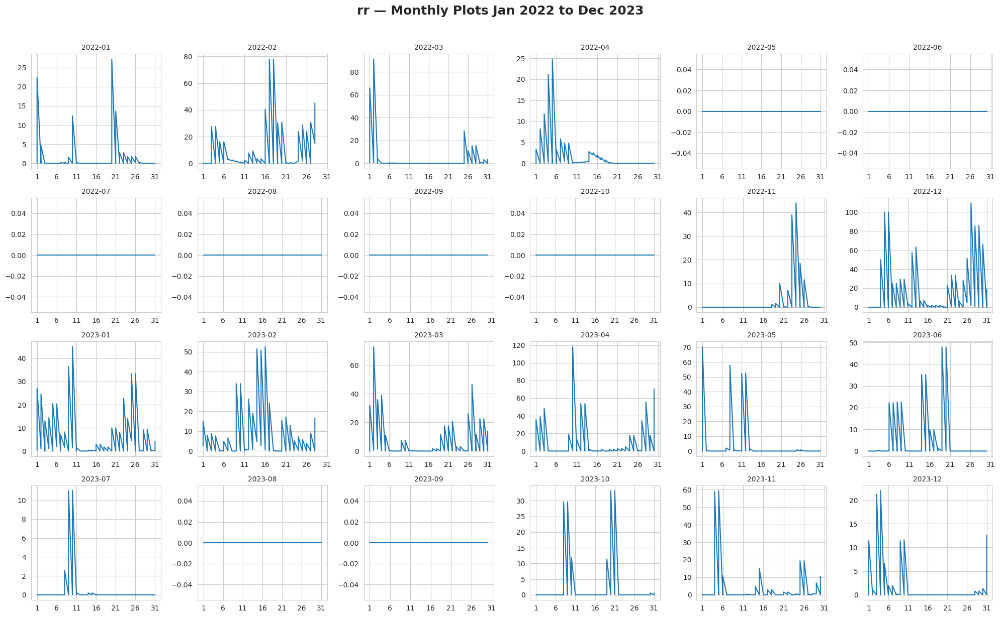

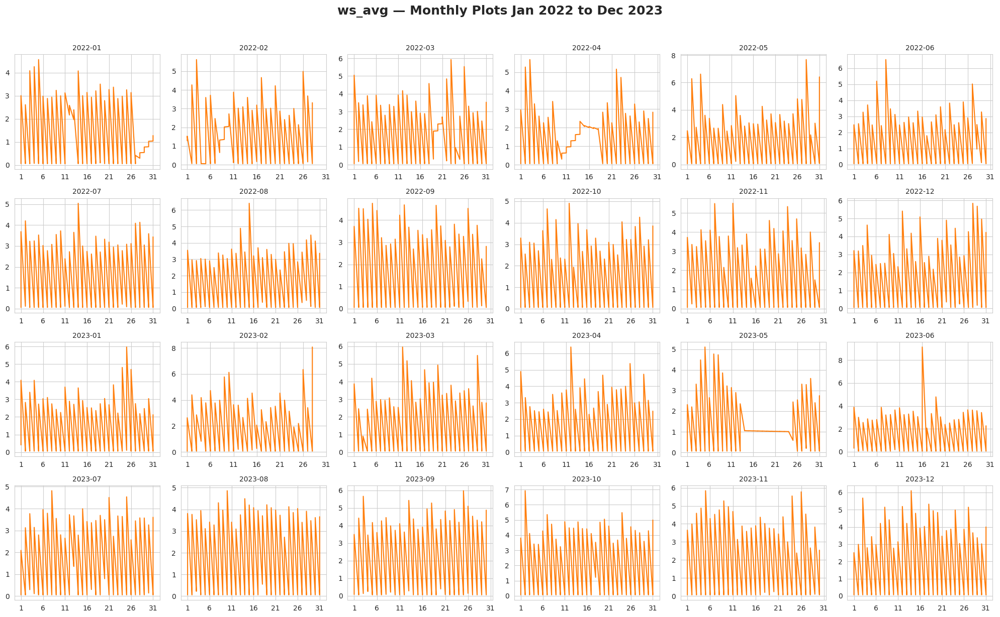

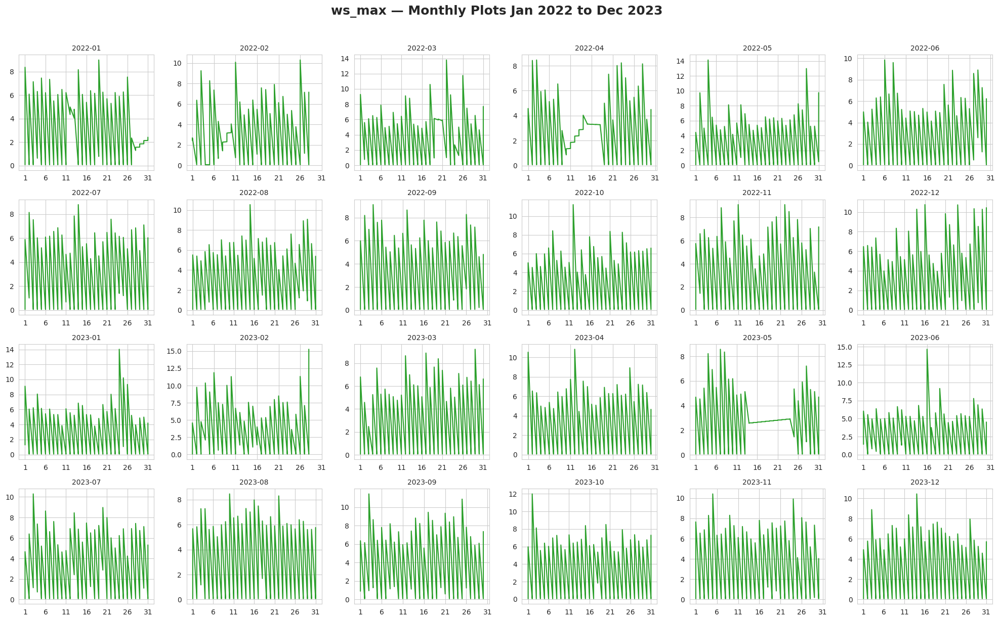

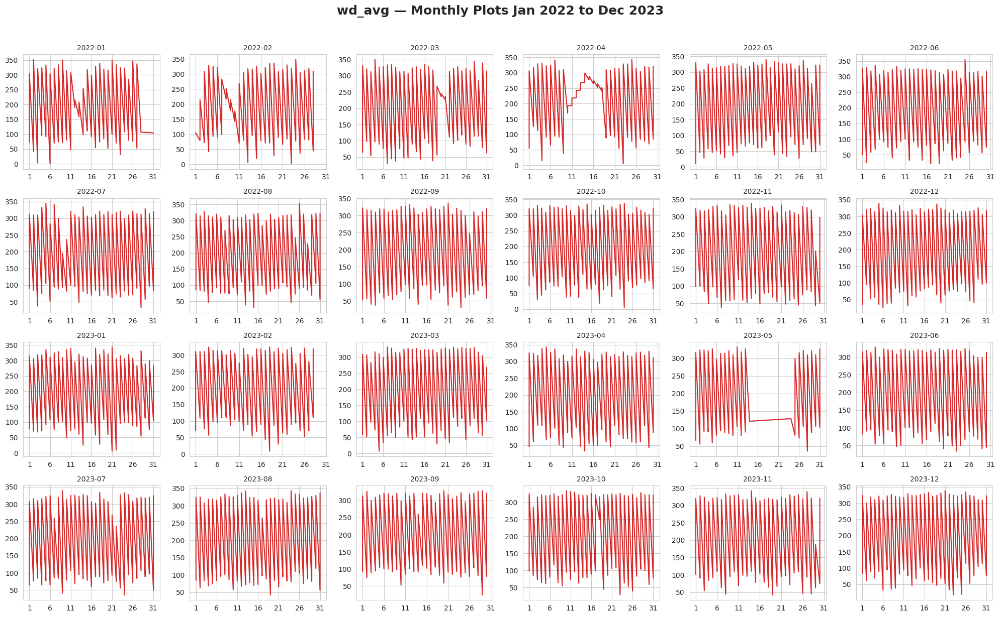

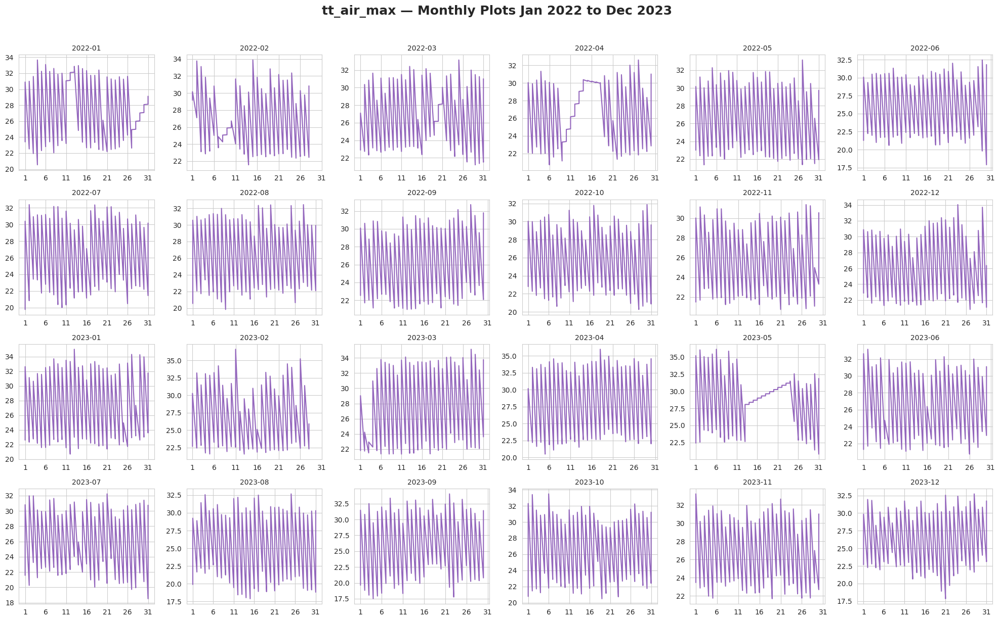

...

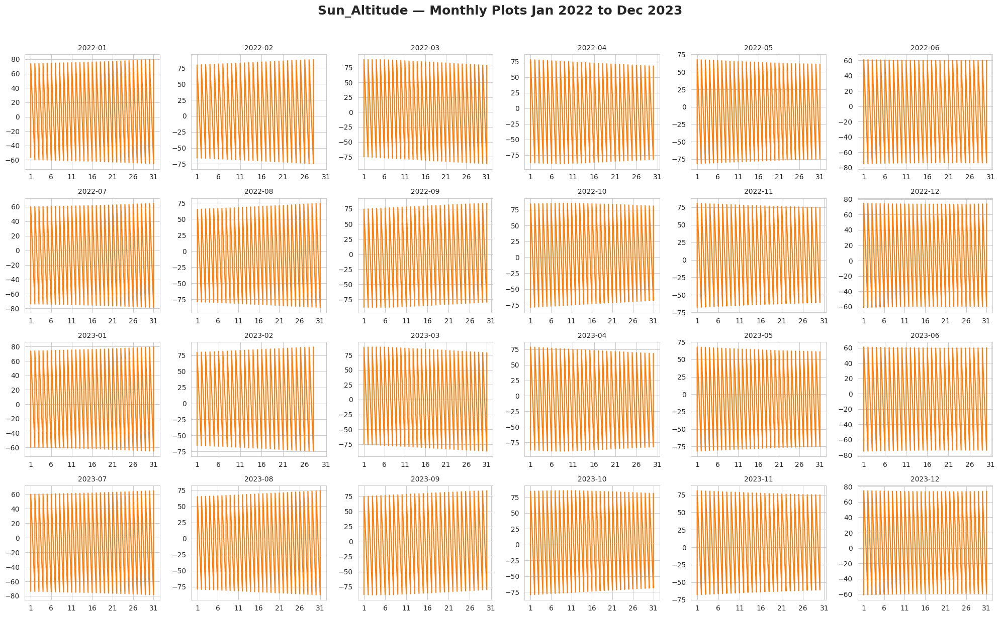

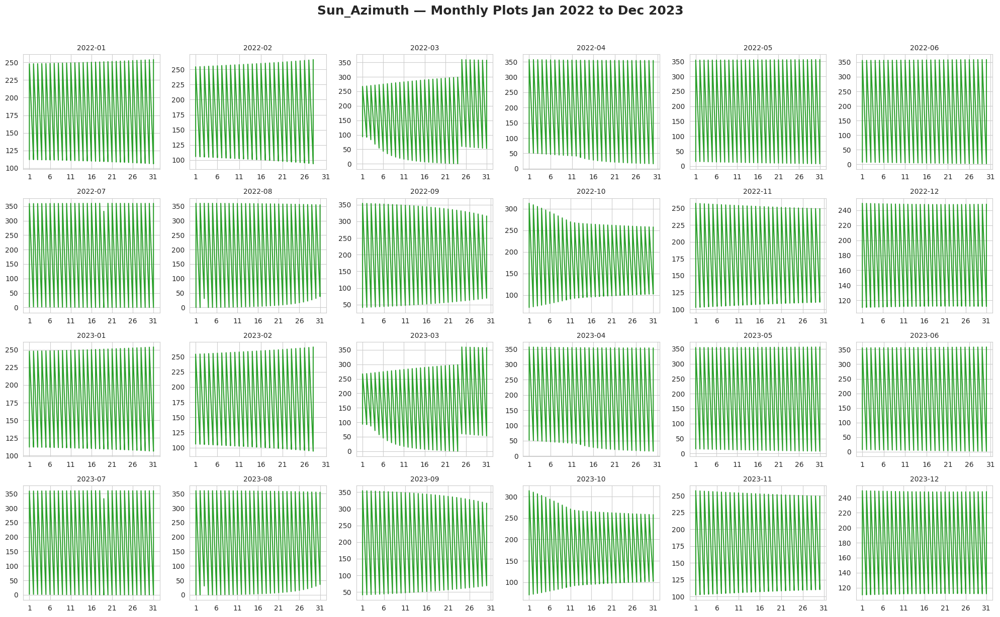

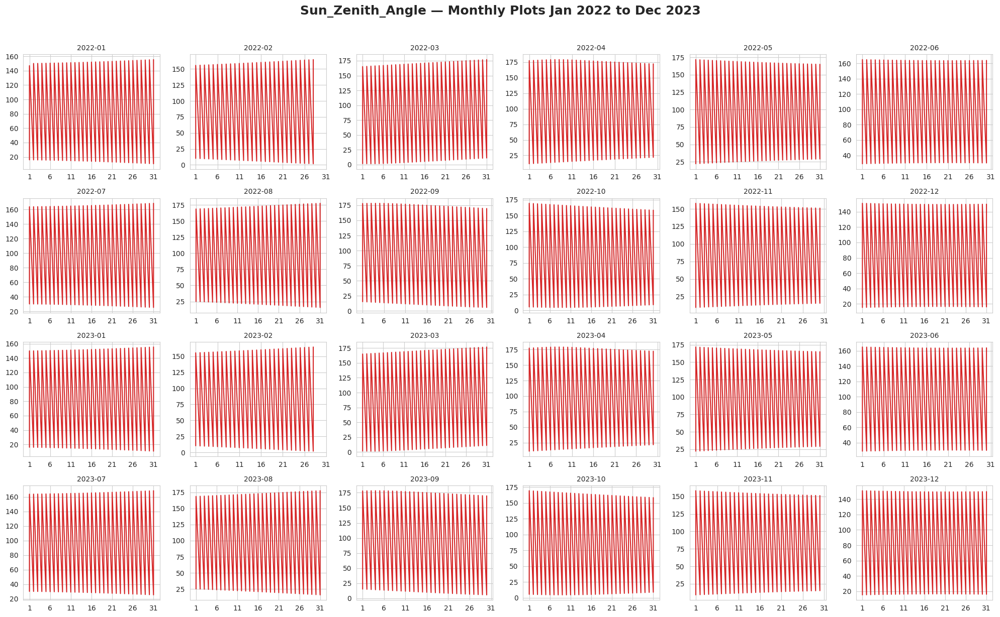

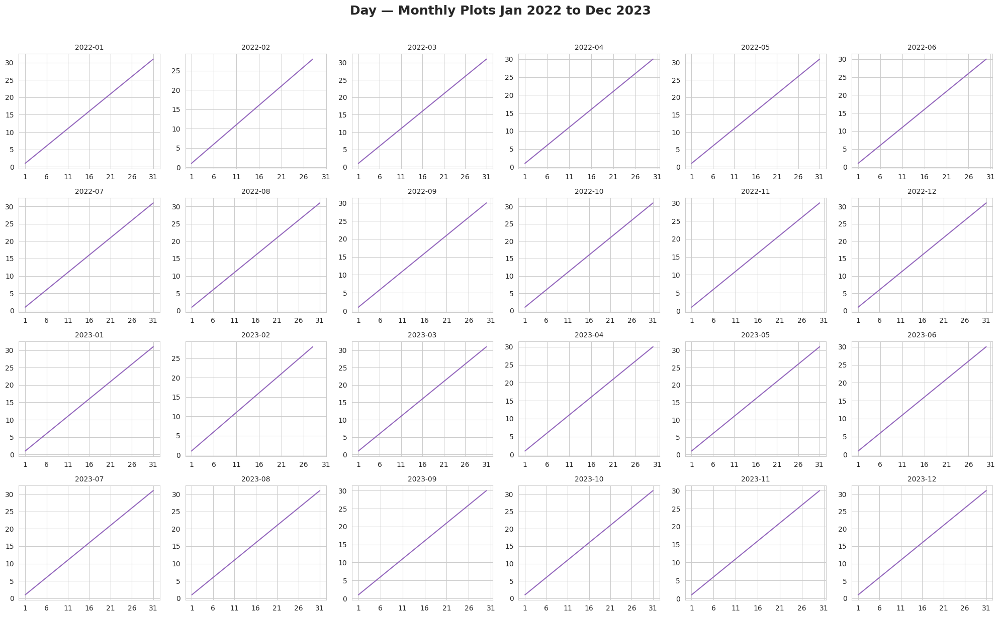

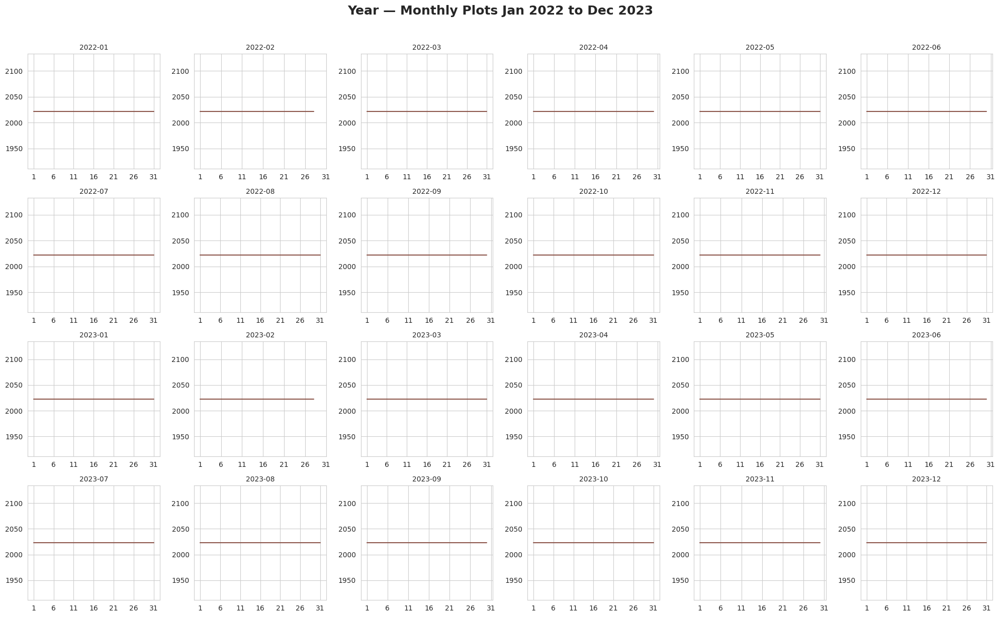

In [ ]:
# --- 26. Plot Execution ---

# A) Monthly plots (Hourly)
plot_monthly_faceted(df_hourly, PLOT_COLUMNS, YEARS_SORTED, COLORS, aggregated=False)

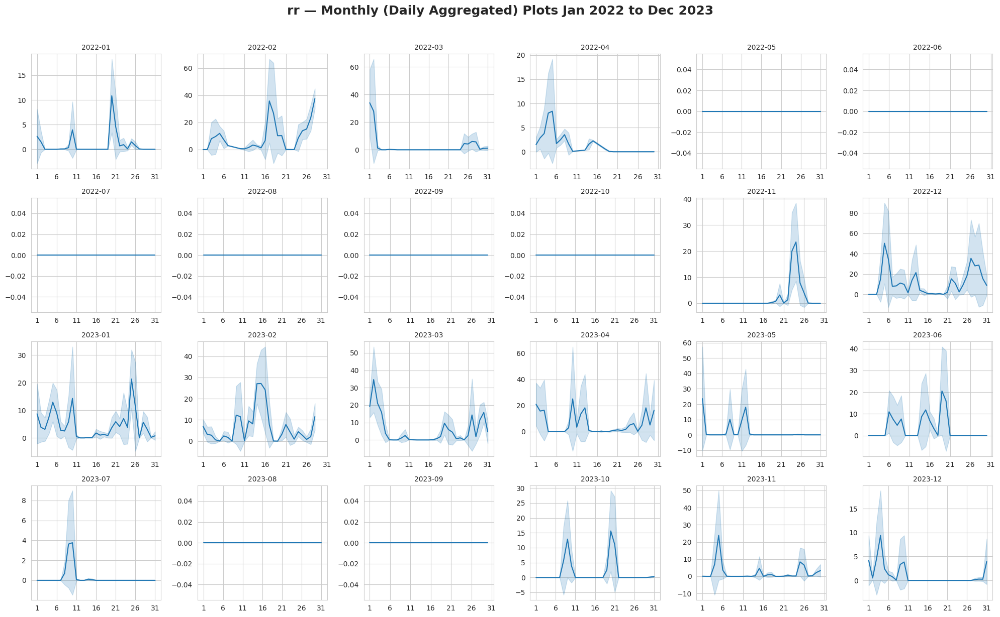

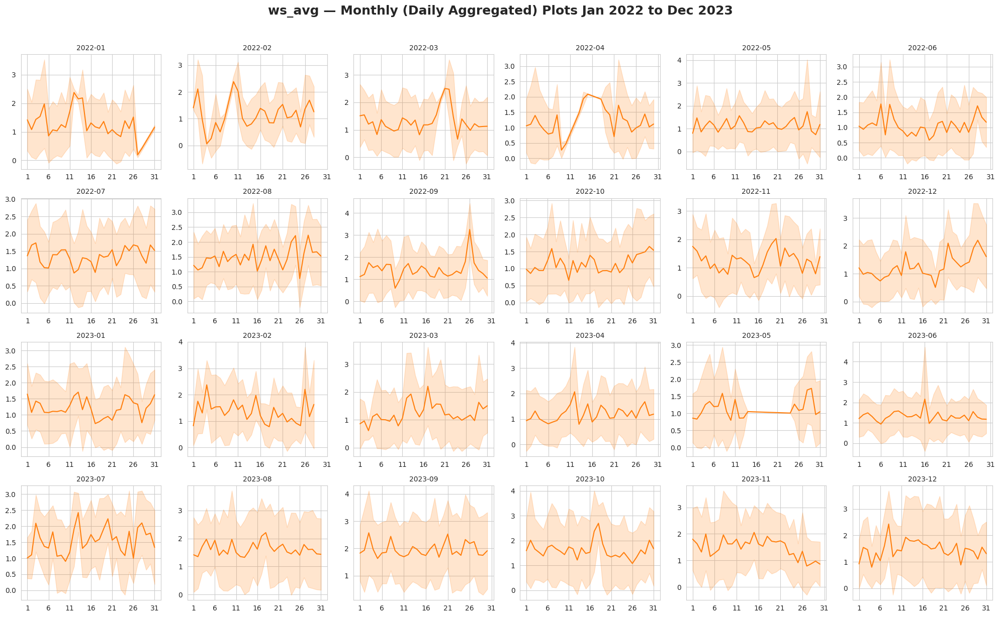

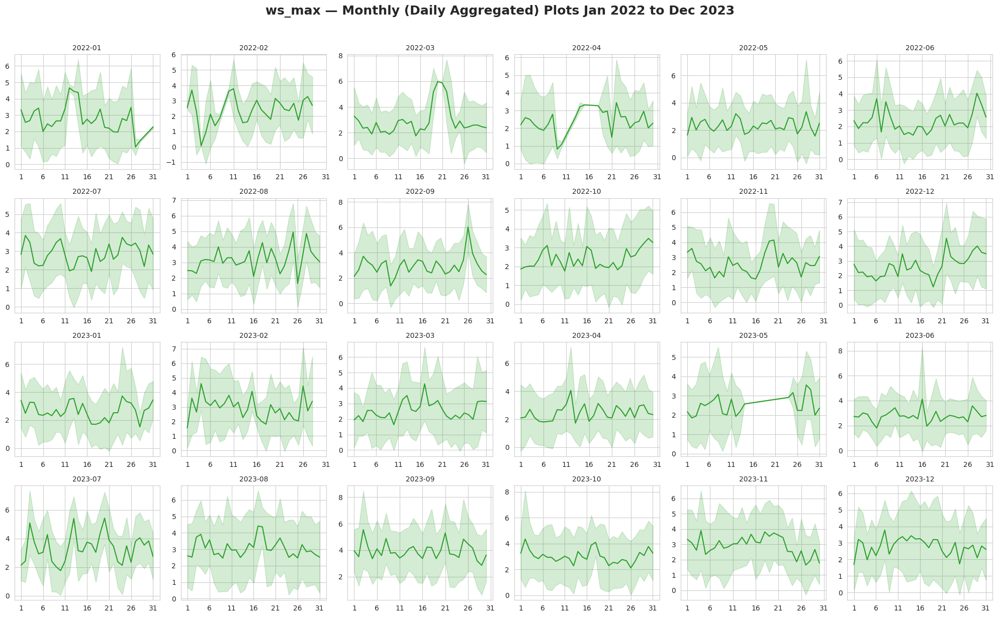

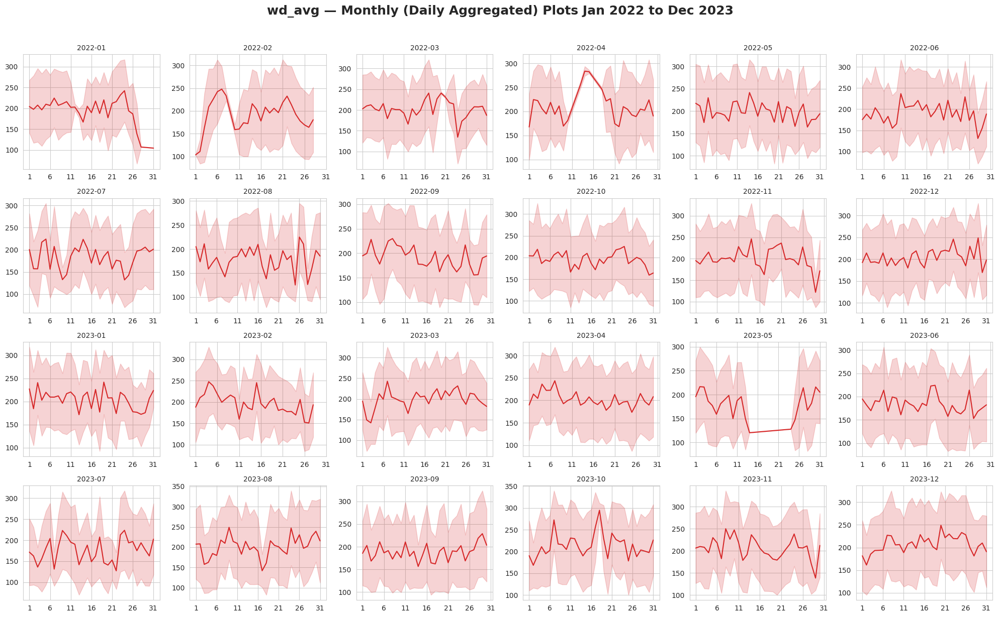

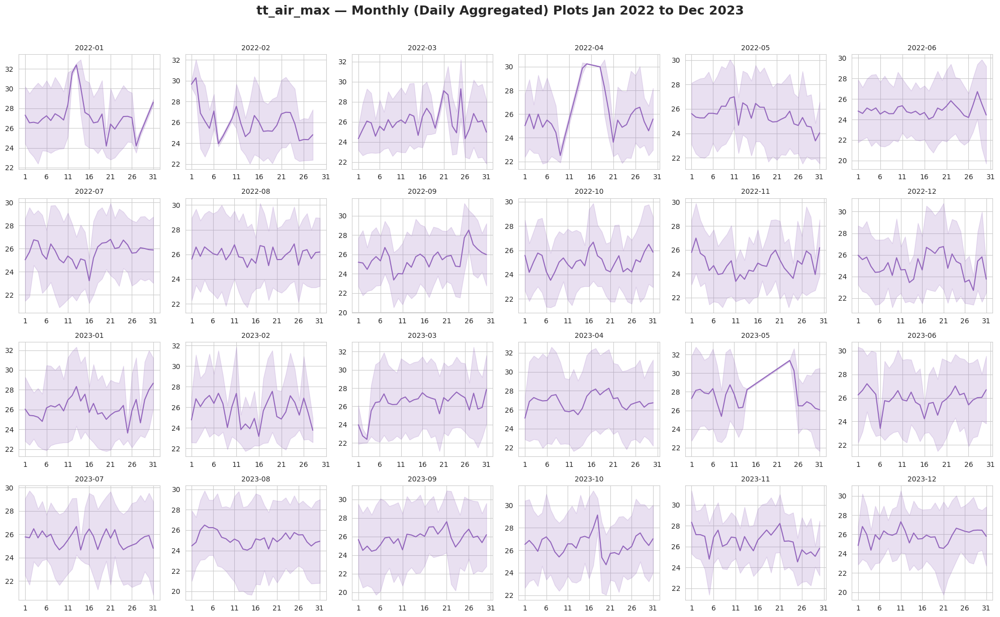

...

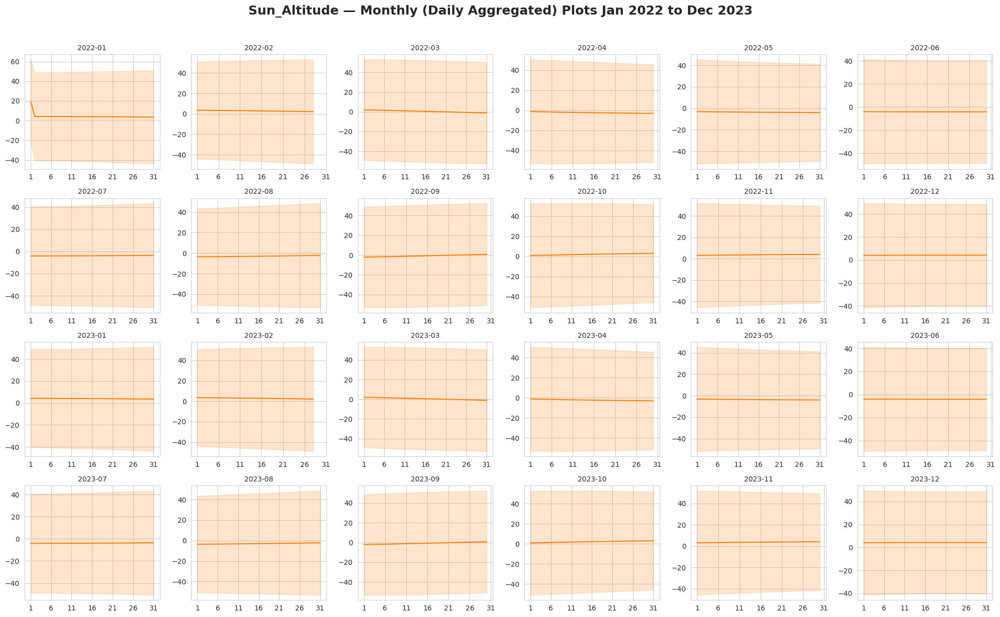

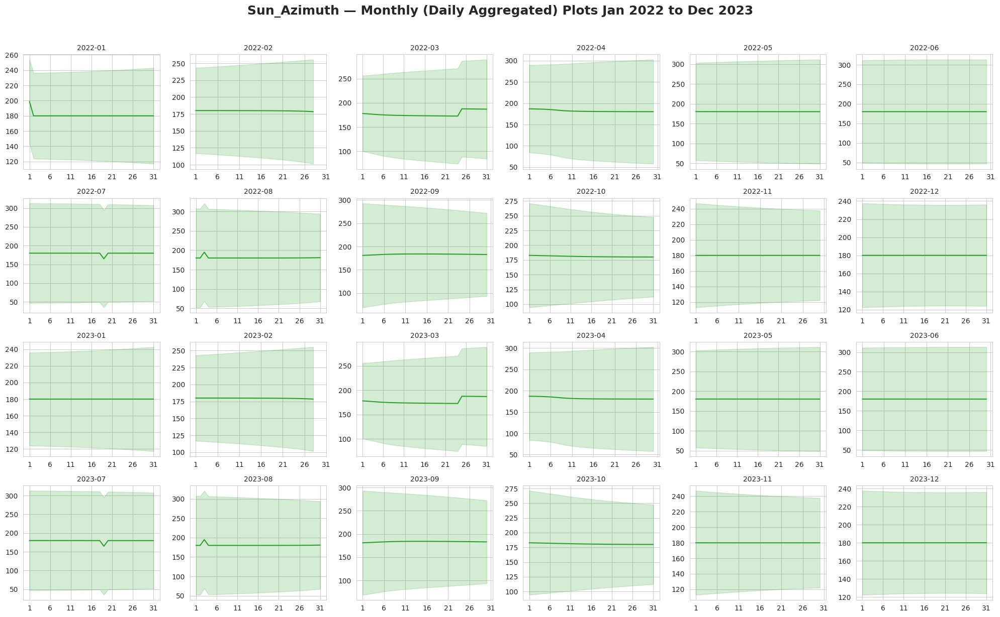

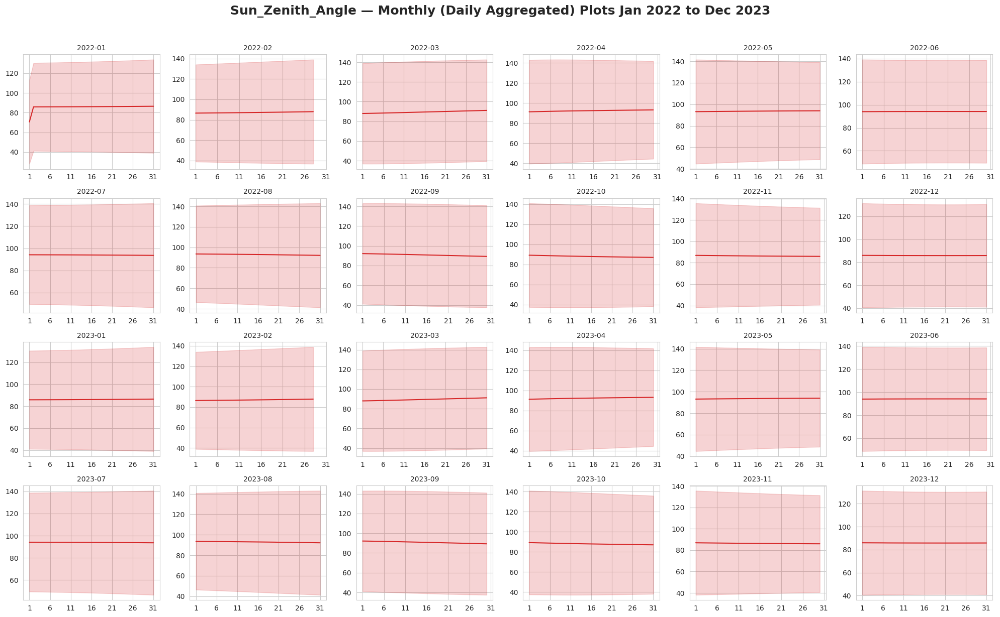

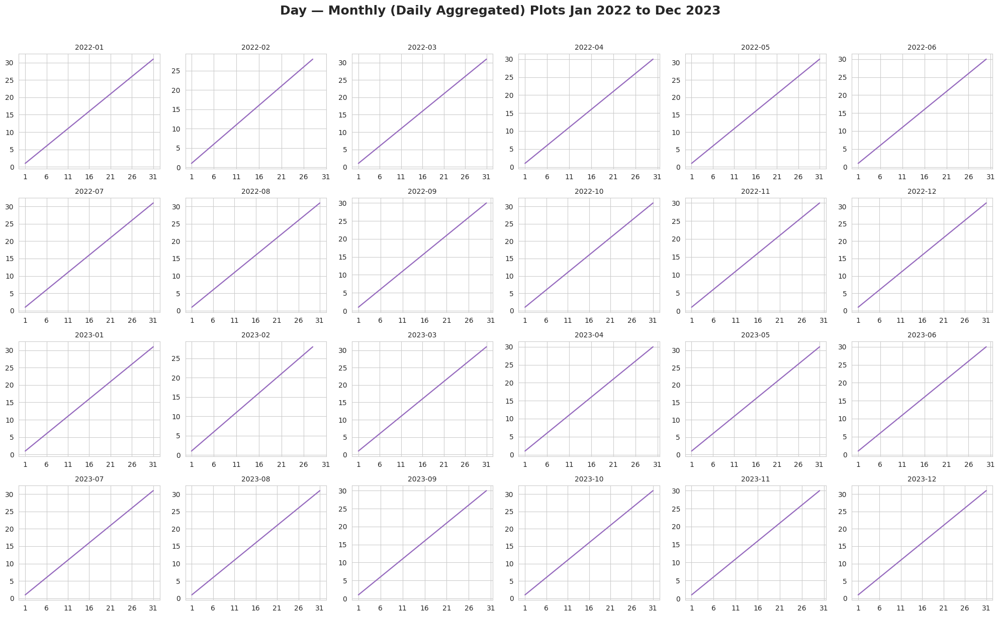

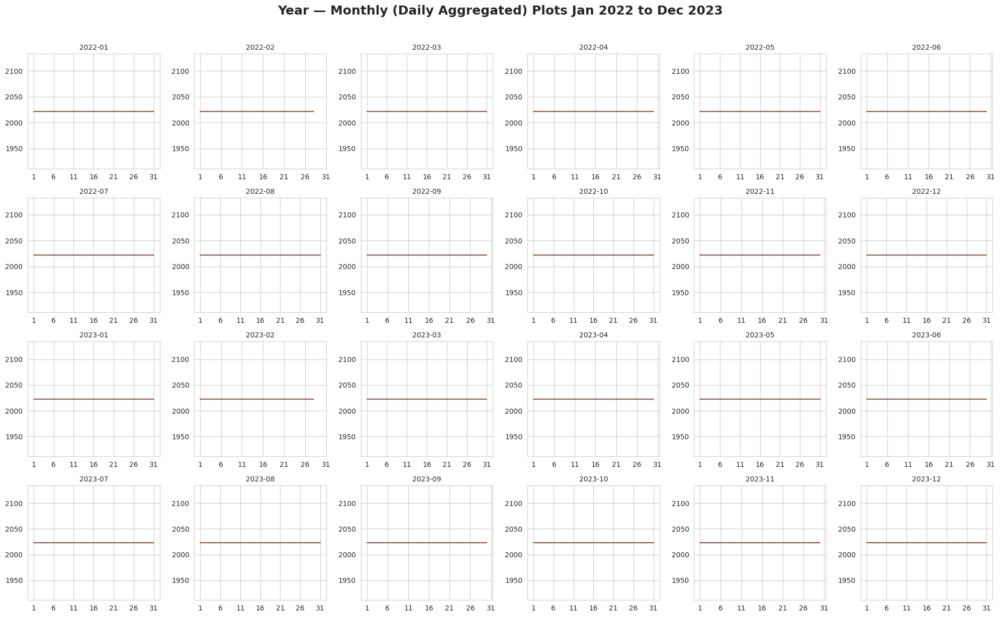

In [ ]:
# B) Monthly plots (Daily Aggregated)
plot_monthly_faceted(df_hourly, PLOT_COLUMNS, YEARS_SORTED, COLORS, aggregated=True)

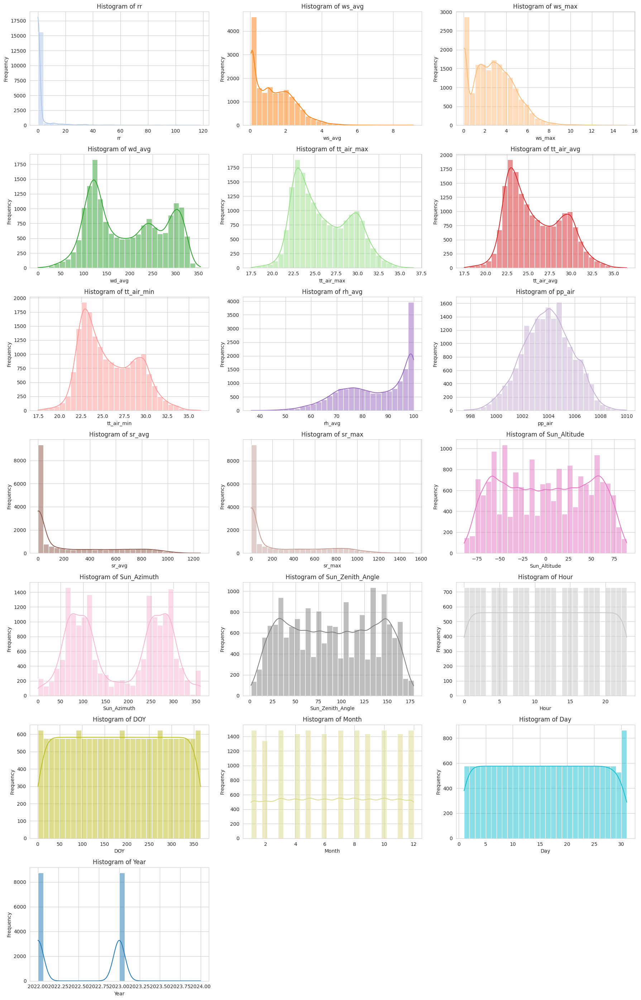

In [ ]:
# C) Histograms
hist_columns = [col for col in df_hourly.columns if col not in ['Time', 'WIB', 'Date']]
plot_histograms(df_hourly, hist_columns, sns.color_palette("tab20", len(hist_columns)))

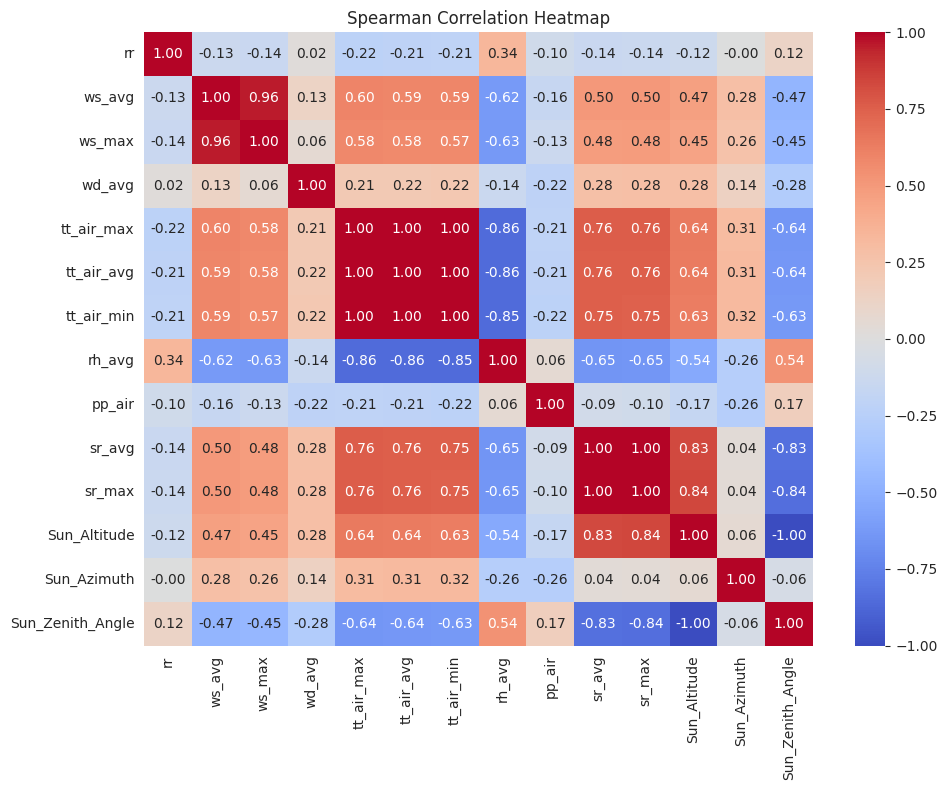

In [ ]:
# D) Spearman heatmap
selected_corr_columns = [
    'rr', 'ws_avg', 'ws_max', 'wd_avg',
    'tt_air_max', 'tt_air_avg', 'tt_air_min',
    'rh_avg', 'pp_air', 'sr_avg', 'sr_max',
    'Sun_Altitude', 'Sun_Azimuth', 'Sun_Zenith_Angle'
]
plot_spearman_heatmap(df_hourly, selected_corr_columns)

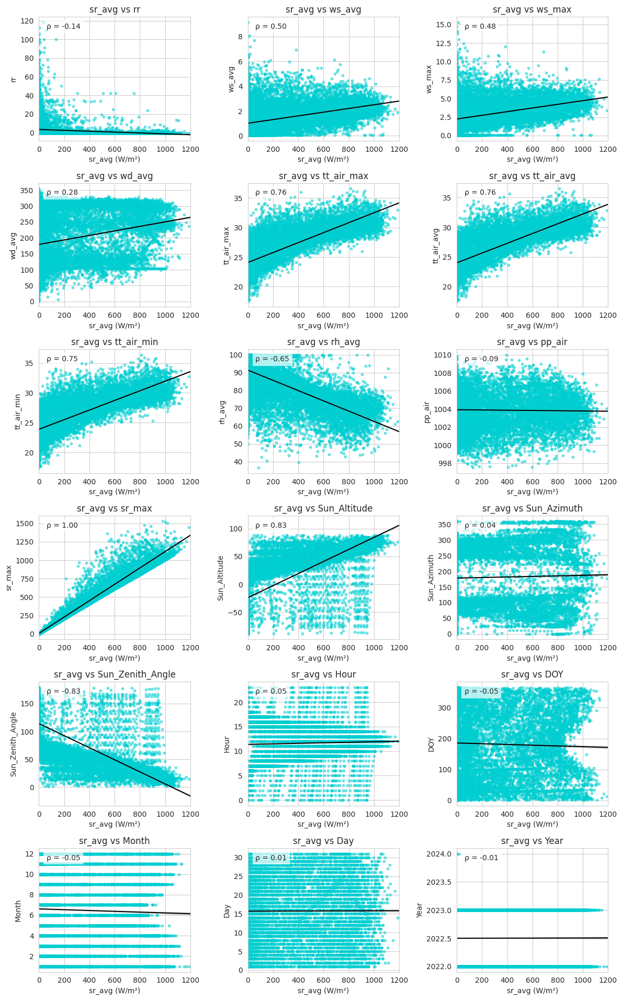

In [ ]:
# E) Scatterplots with correlation
scatter_columns = [col for col in df_hourly.columns if col not in ['Time', 'WIB', 'sr_avg', 'Date']]
plot_scatter_with_corr(df_hourly, 'sr_avg', scatter_columns)